In [ ]:
import numpy as np
import tensorflow
import keras
import os
import glob
from skimage import io
import skimage
import random
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
import os

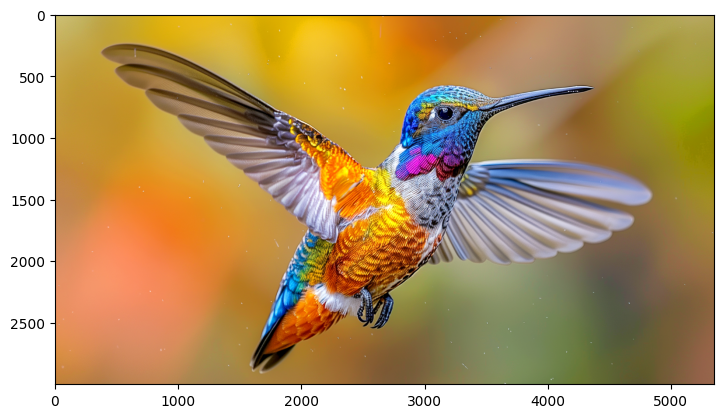

In [ ]:
# accessing an image file from the dataset classes
image = io.imread('/content/drive/MyDrive/Colab Notebooks/bird.jpg')
i, (im1) = plt.subplots(1)
i.set_figwidth(15)
im1.imshow(image)

Text(0.5, 0.98, 'Original & RGB image channels')

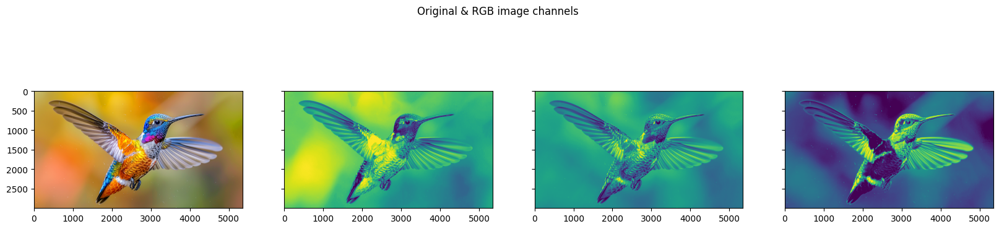

In [ ]:
i, (im1, im2, im3, im4) = plt.subplots(1, 4, sharey=True)
i.set_figwidth(20)
im1.imshow(image) #Original image
im2.imshow(image[:, : , 0]) #Red
im3.imshow(image[:, : , 1]) #Green
im4.imshow(image[:, : , 2]) #Blue
i.suptitle('Original & RGB image channels')



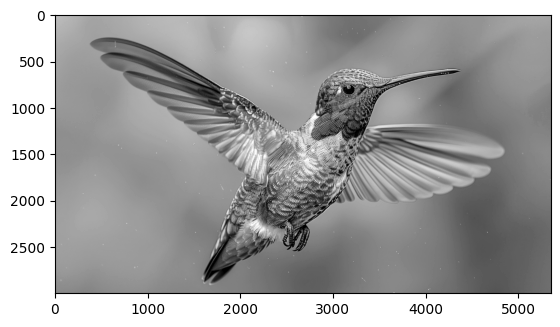

In [ ]:
gray_image = skimage.color.rgb2gray(image)
plt.imshow(gray_image, cmap = 'gray')

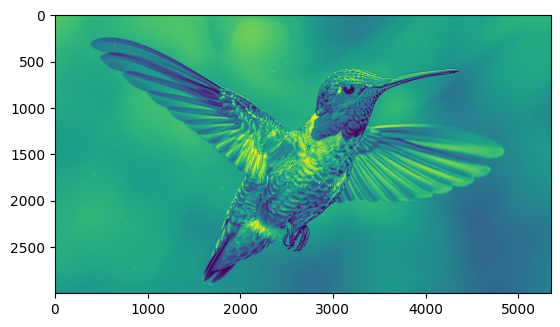

In [ ]:
norm_image = (gray_image - np.min(gray_image)) / (np.max(gray_image) - np.min(gray_image))
plt.imshow(norm_image)

In [ ]:

!pip install keras_preprocessing

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 2.4 MB/s eta 0:00:00


In [ ]:
from numpy import expand_dims
from keras_preprocessing.image import load_img
from keras_preprocessing.image import img_to_array
from keras_preprocessing.image import ImageDataGenerator

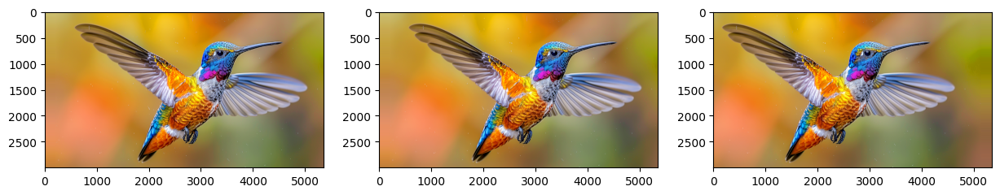

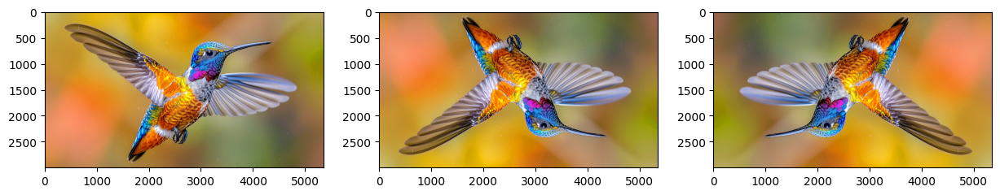

In [ ]:
data = img_to_array(image)
samples = expand_dims(image, 0)

# ImageDataGenerator for shifting width
datagen = ImageDataGenerator(width_shift_range=[-200,200])

# create an iterator  (This should be defined before the loop)
it = datagen.flow(samples, batch_size=1)

fig, im = plt.subplots(nrows=1, ncols=3, figsize=(15,15))

# generate batch of images
for i in range(3):
  # convert to unsigned integers
  images = next(it)[0].astype('uint8')
  # plot image
  im[i].imshow(images)

# ImageDataGenerator for flipping
datagen = ImageDataGenerator(horizontal_flip=True, vertical_flip=True)

# create an iterator (Redefine for the new datagen)
it = datagen.flow(samples, batch_size=1)

fig, im = plt.subplots(nrows=1, ncols=3, figsize=(15,15))

# generate batch of images
for i in range(3):
  # convert to unsigned integers
  images = next(it)[0].astype('uint8')
  # plot image
  im[i].imshow(images)


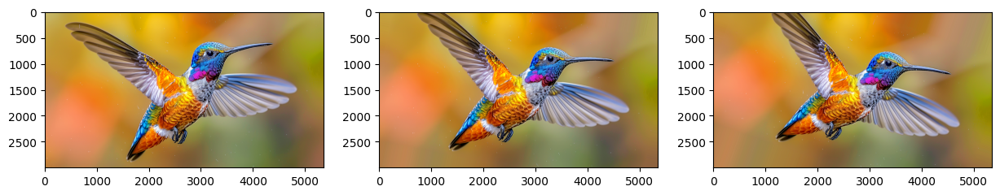

In [ ]:
# ImageDataGenerator for rotation
datagen = ImageDataGenerator(rotation_range=20, fill_mode='nearest')
# create an iterator
it = datagen.flow(samples, batch_size=1)
fig, im = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
# generate batch of images
for i in range(3):
  # convert to unsigned integers
  images = next(it)[0].astype('uint8')
  # plot image
  im[i].imshow(images)


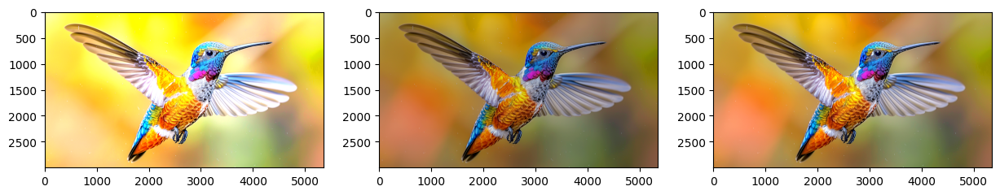

In [ ]:
# ImageDataGenerator for brightness
datagen = ImageDataGenerator(brightness_range=[0.5,2.0])
# create an iterator
it = datagen.flow(samples, batch_size=1)
fig, im = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
# generate batch of images
for i in range(3):
  # convert to unsigned integers
  images = next(it)[0].astype('uint8')
  # plot image
  im[i].imshow(images)


/usr/local/lib/python3.10/dist-packages/keras_preprocessing/image/image_data_generator.py:720: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn('This ImageDataGenerator specifies '
/usr/local/lib/python3.10/dist-packages/keras_preprocessing/image/image_data_generator.py:728: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn('This ImageDataGenerator specifies '


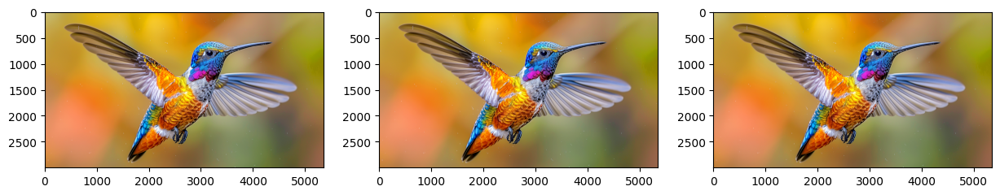

In [ ]:
# creating the image data generator to standardize images
datagen = ImageDataGenerator(featurewise_center =True,
featurewise_std_normalization = True)
# create an iterator
it = datagen.flow(samples, batch_size=1)
fig, im = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
# generate batch of images
for i in range(3):
  # convert to unsigned integers
  images = next(it)[0].astype('uint8')
  # plot image
  im[i].imshow(images)


Shape: (3000, 5353, 3)


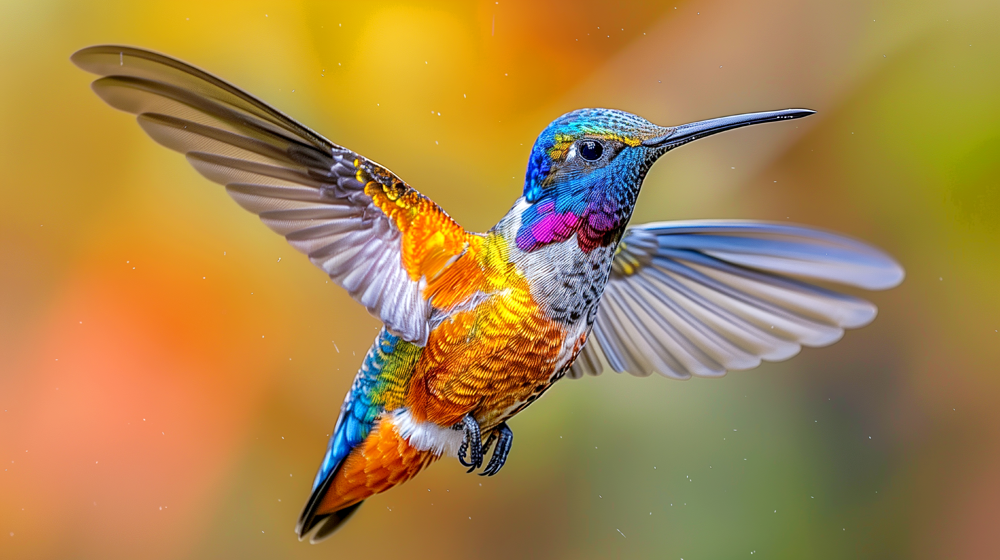

In [ ]:
from google.colab.patches import cv2_imshow
image = cv2.imread("/content/drive/MyDrive/Colab Notebooks/bird.jpg")
print("Shape:", image.shape)
cv2_imshow(image)

In [ ]:
up_x = 1.8
up_y = 1.4
scaled_up = cv2.resize(image, None, fx= up_x, fy= up_y, interpolation=cv2.INTER_LINEAR)
print("\nScaled Up\n")
cv2_imshow(scaled_up)


Scaled Up



Scaled Down



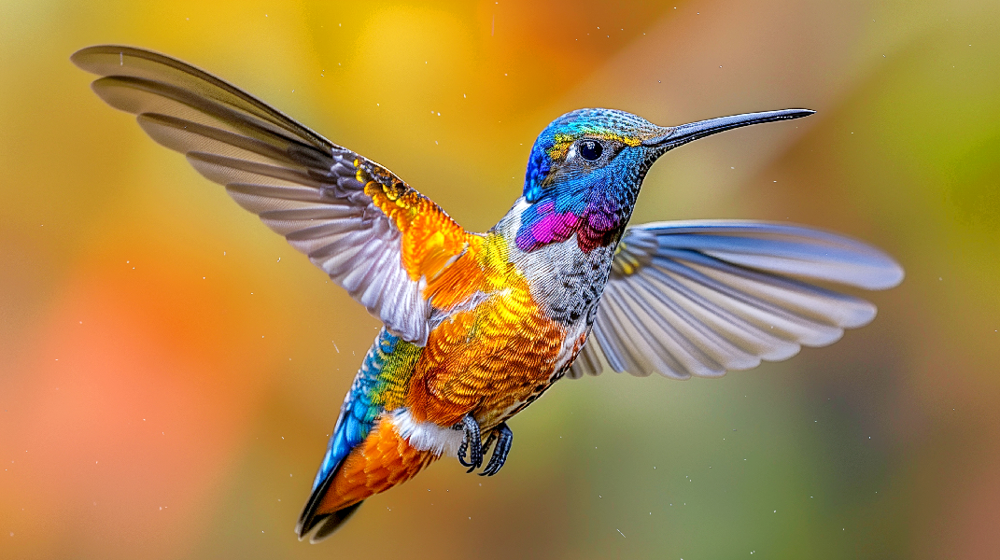

In [ ]:
down = 0.2
scaled_down = cv2.resize(image, None, fx=down, fy=down, interpolation=cv2.INTER_LINEAR)
print("Scaled Down\n")
cv2_imshow(scaled_down)


Resized Up by defining height and width



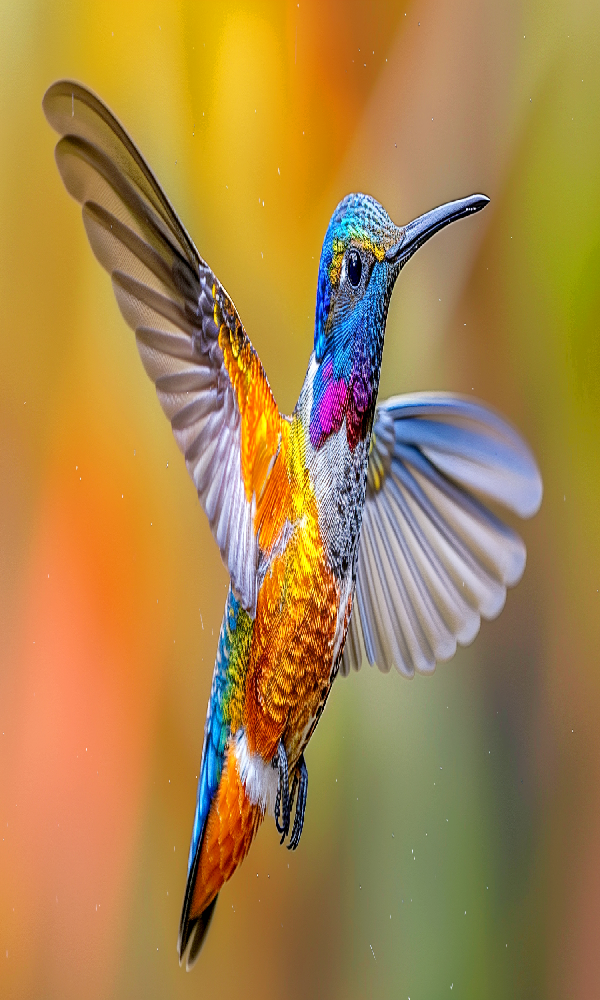

In [ ]:
up_width = 1500
up_height = 2500
up_points = (up_width, up_height)
resize_up = cv2.resize(image, up_points, interpolation = cv2.INTER_LINEAR)
print("\nResized Up by defining height and width\n")
cv2_imshow(resize_up)


Resized Up by defining height and width



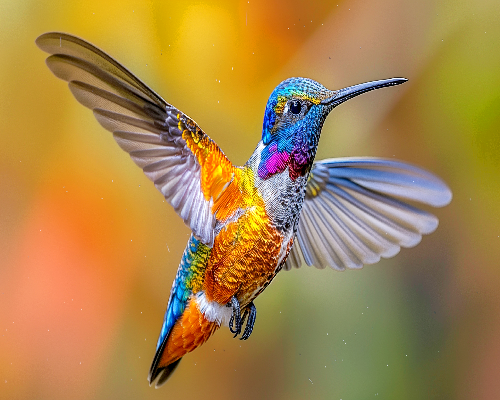

In [ ]:
up_width = 500
up_height = 400
up_points = (up_width, up_height)
resize_down = cv2.resize(image, up_points, interpolation = cv2.INTER_LINEAR)
print("\nResized Up by defining height and width\n")
cv2_imshow(resize_down)